In [ ]:
import torch
import json
import cv2
import matplotlib.pyplot as plt
from os import listdir
from os.path import isfile, join
from google.colab import drive
import pandas as pd
from sklearn.model_selection import train_test_split
usuario=2
while usuario not in(0,1,2):
  usuario=int(input('¿Quién sos? 0.Sofi 1.Nicky 2.Azu:'))


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


Primero contamos si están todas las imagenes en la carpeta de archivos .txt

In [ ]:
import os
usuario=0
def count_txt_files(directory):
    # Contar todos los archivos con la extensión .txt en el directorio dado
    txt_count = sum(1 for filename in os.listdir(directory) if filename.endswith('.txt'))
    return txt_count

directory = '/content/drive/MyDrive/Proyecto final/TXT DATA'  # Path Sofi


number_of_txt_files = count_txt_files(directory)
print(f"Hay {number_of_txt_files} archivos .txt en la carpeta.")

Hay 1978 archivos .txt en la carpeta.


In [ ]:
import os

def count_txt_files(directory):
    # Contar todos los archivos con la extensión .txt en el directorio dado
    txt_count = sum(1 for filename in os.listdir(directory) if filename.endswith('.png'))
    return txt_count


directory = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/images'  # Path sofi

number_of_txt_files = count_txt_files(directory)
print(f"Hay {number_of_txt_files} archivos .png en la carpeta.")

Hay 1582 archivos .png en la carpeta.


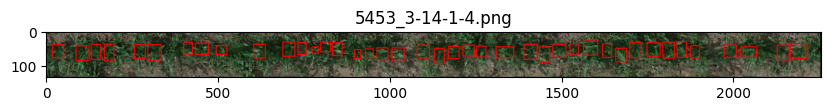

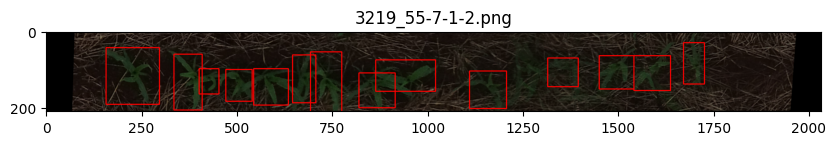

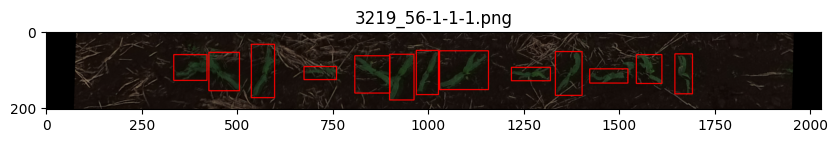

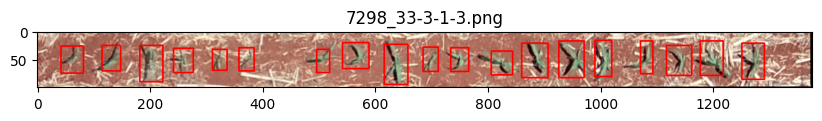

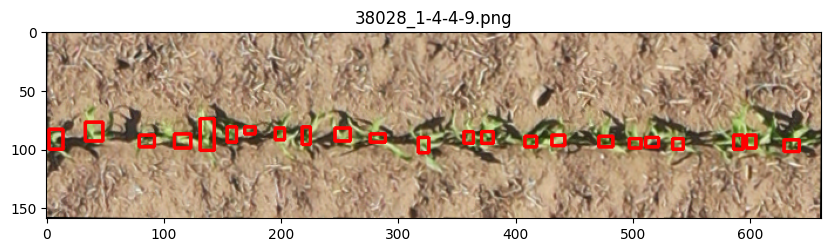

...

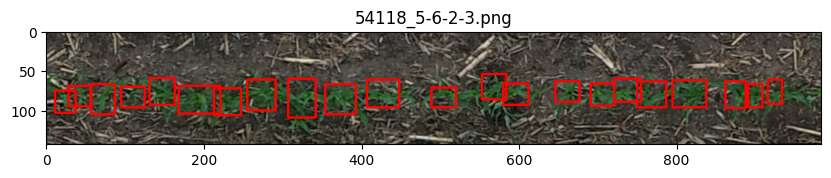

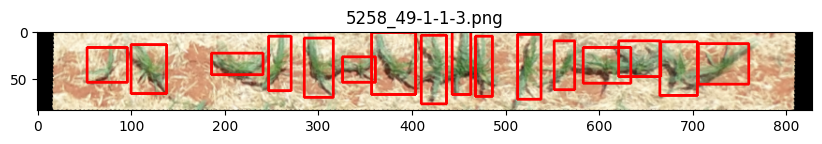

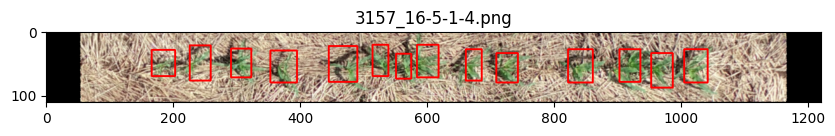

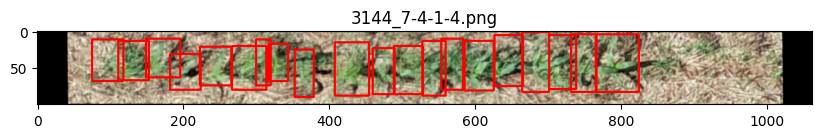

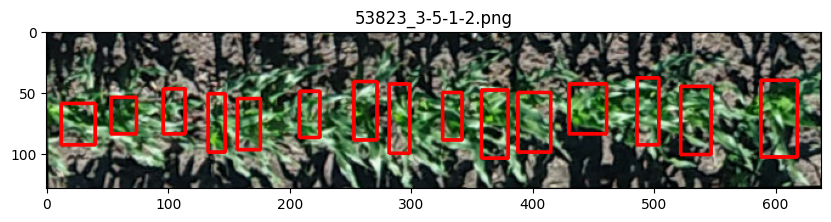

In [ ]:
import cv2
import matplotlib.pyplot as plt

def draw_yolo_annotations(image_folder, label_folder):
    # Lista todos los archivos en la carpeta de imágenes y anotaciones
    image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]
    label_files = [f for f in os.listdir(label_folder) if f.endswith('.txt')]

    # Procesar cada archivo de imagen
    for img_file in image_files:
        base_name = os.path.splitext(img_file)[0]
        label_file = f"{base_name}.txt"

        # Verifica que el archivo de etiquetas exista
        if label_file in label_files:
            image_path = os.path.join(image_folder, img_file)
            label_path = os.path.join(label_folder, label_file)

            # Carga la imagen
            image = cv2.imread(image_path)
            if image is None:
                print(f"Error cargando la imagen {image_path}")
                continue
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Leer el archivo .txt con anotaciones YOLO y dibujarlas
            with open(label_path, 'r') as file:
                for line in file:
                    parts = line.strip().split()
                    x_center, y_center, w, h = map(float, parts[1:])
                    x_center *= image.shape[1]
                    y_center *= image.shape[0]
                    w *= image.shape[1]
                    h *= image.shape[0]
                    x1 = int(x_center - w / 2)
                    y1 = int(y_center - h / 2)
                    x2 = int(x_center + w / 2)
                    y2 = int(y_center + h / 2)

                    # Dibujar el rectángulo sobre la imagen
                    cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)

            # Mostrar la imagen
            plt.figure(figsize=(10, 10))
            plt.imshow(image)
            plt.title(img_file)
            plt.show()
        else:
            print(f"No se encontró archivo de etiquetas para {img_file}")

# Rutas a las carpetas de imágenes y etiquetas

image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Validacion/images'
label_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels'

draw_yolo_annotations(image_folder, label_folder)


Dividir entrenamiento y testeo teniendo en cuenta las labels:

- Oscuras
- Rastrojo y maleza
- Borrosas
- Rojas
- Plantas dobles
- Plantas crecidas
- Regiones

1) Extracción de layout_id

Asociamos las imagenes y .txt a sus tags

In [ ]:
# Paths a las carpetas de imágenes y etiquetas
image_folder = '/content/drive/MyDrive/Proyecto final/clean_images'
label_folder = '/content/drive/MyDrive/Proyecto final/TXT DATA'
excel_path = '/content/drive/MyDrive/Proyecto final/Layout Tags.xlsx'

# Leer el archivo Excel
layout_tags = pd.read_excel(excel_path)
layout_to_tags = layout_tags.set_index('layout_id')['relevant (new) tags'].to_dict()

image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]
label_files = [f for f in os.listdir(label_folder) if f.endswith('.txt')]

image_files.sort()
label_files.sort()
assert len(image_files) == len(label_files), "La cantidad de imágenes y archivos .txt no coincide"

In [ ]:
import os
image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/images'
label_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/labels'
excel_path = '/content/drive/MyDrive/Proyecto final/Layout Tags.xlsx'

# Leer el archivo Excel
layout_tags = pd.read_excel(excel_path)
layout_to_tags = layout_tags.set_index('layout_id')['relevant (new) tags'].to_dict()

image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]
label_files = [f for f in os.listdir(label_folder) if f.endswith('.txt')]

image_files.sort()
label_files.sort()
assert len(image_files) == len(label_files), "La cantidad de imágenes y archivos .txt no coincide"

In [ ]:
# Extraer los layout_id de los nombres de los archivos
file_layout_ids = [f.split('_')[0] for f in image_files]

# Asociar cada archivo con su layout_id y etiqueta relevante
file_tags = [layout_to_tags.get(int(layout_id), 'Unknown') for layout_id in file_layout_ids]


Notemos que cada imagen puede tener mas de un tag

In [ ]:
file_tags

['4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,

PROBLEMA ENCONTRADO!!
Una foto puede tener varias etiquetas por lo que no se pueden dividir equitativamente entrenamiento y testeo segun todas las etiquetas

Por esta razon se decidio ponderar las etiquetas segun la rareza de las mismas (mayor ponderación a las etiquetas que menos seguido aparecen)

In [ ]:
file_tags_str = [str(tags) if not isinstance(tags, str) else tags for tags in file_tags]
tag_sets = [set(tags.split(',')) for tags in file_tags_str]
tag_sets = [{tag.strip() for tag in tags if tag.strip()} for tags in tag_sets]
# tag_sets

In [ ]:
tag_freq = {}
for tags in tag_sets:
    for tag in tags:
        if tag:  # Verifica que el tag no esté vacío
            tag_freq[tag] = tag_freq.get(tag, 0) + 1
tag_freq

{'11': 814,
 '4': 1057,
 '6': 689,
 '5': 1250,
 '8': 251,
 '2': 705,
 '7': 330,
 '3': 436,
 '1': 430,
 '9': 160,
 '10': 440}

In [ ]:
# Ordenamos las etiquetas por su frecuencia para dar prioridad a las más raras
sorted_tags = sorted(tag_freq, key=tag_freq.get)
sorted_tags

['9', '8', '7', '1', '3', '10', '6', '2', '11', '4', '5']

Ahora a cada imagen le asignamos de todas sus etiquetas, la mas rara

In [ ]:
# Asignamos la etiqueta más rara de cada conjunto a la imagen
priority_tags = [min(tags, key=lambda t: sorted_tags.index(t)) if tags else 'Unknown' for tags in tag_sets]
# priority_tags

A PARTIR DE ACA NO CORRER EL CODIGO

In [ ]:

X_train, X_test, _, _ = train_test_split(
    image_files, priority_tags, test_size=0.125, random_state=42, stratify=priority_tags
 )

print(f"Entrenamiento: {len(X_train)}, Testeo: {len(X_test)}")


Entrenamiento: 1384, Testeo: 198


## Partición sin volver a dividir en las carpetas:

Copio el train y test a sus respectivas carpetas

In [ ]:
import shutil
import os



image_folder = '/content/drive/MyDrive/Proyecto final/clean_images'
train_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Train_Images'

os.makedirs(train_image_folder, exist_ok=True)

# Función para copiar archivos de imagen
def copy_images(file_list, source_folder, destination_folder):
    for filename in file_list:
         source_path = os.path.join(source_folder, filename)
         destination_path = os.path.join(destination_folder, filename)
         if os.path.exists(source_path):
             shutil.copy(source_path, destination_path)
             print(f"Imagen {filename} copiada correctamente a {destination_folder}.")
         else:
             print(f"Error: La imagen {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen
# Copiar las imágenes a la carpeta de destino
copy_images(X_train, image_folder, train_image_folder)

print("Las imágenes de entrenamiento han sido copiadas a la carpeta correspondiente.")


Verificamos si se copiaron todas las imagenes de train

In [ ]:
def count_png_files(directory):
  # Contar todos los archivos con la extensión .txt en el directorio dado
    txt_count = sum(1 for filename in os.listdir(directory) if filename.endswith('.png'))
    return txt_count

# Usar la función
directory = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/images'  # Cambia esto por la ruta de tu carpeta
number_of_txt_files = count_png_files(directory)
print(f"Hay {number_of_txt_files} archivos .png en la carpeta.")

Hay 1582 archivos .png en la carpeta.


In [ ]:
import shutil

image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/images'
test_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Val_Images'



os.makedirs(test_image_folder, exist_ok=True)


def copy_images(file_list, source_folder, destination_folder):
     for filename in file_list:
         source_path = os.path.join(source_folder, filename)
         destination_path = os.path.join(destination_folder, filename)
         if os.path.exists(source_path):
             shutil.copy(source_path, destination_path)
             print(f"Imagen {filename} copiada correctamente a {destination_folder}.")
         else:
             print(f"Error: La imagen {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen

copy_images(X_test, image_folder, test_image_folder)

# print("Las imágenes de testeo han sido copiadas a la carpeta correspondiente.")

Imagen 5453_3-14-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 3219_55-7-1-2.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 3219_56-1-1-1.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 7298_33-3-1-3.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 38028_1-4-4-9.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 54054_14-9-1-2.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 38454_1-1-9-8.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 7106_67-4-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 3181_74-4-1-1.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Val_Images.
Imagen 72

In [ ]:
directory = '/content/drive/MyDrive/Proyecto final/Train_Test/Val_Images'


number_of_txt_files = count_png_files(directory)
print(f"Hay {number_of_txt_files} archivos .png en la carpeta.")

Hay 198 archivos .png en la carpeta.


In [ ]:
import os
import shutil

TXT_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/labels'
TXT_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels'

os.makedirs(TXT_image_folder, exist_ok=True)

# Función para copiar archivos de imagen
def copy_images(file_list, source_folder, destination_folder):
    for filename in file_list:
        source_path = os.path.join(source_folder, filename)
        destination_path = os.path.join(destination_folder, filename)
        if os.path.exists(source_path):
            if not os.path.exists(destination_path):
                shutil.copy(source_path, destination_path)
                print(f"Archivo {filename} copiado correctamente a {destination_folder}.")
            else:
                print(f"El archivo {filename} ya existe en {destination_folder}. No se copiará nuevamente.")
        else:
            print(f"Error: El archivo {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen
# Copiar las imágenes a la carpeta de destino
y_test = [filename.replace('.png', '.txt') for filename in X_test]
copy_images(y_test, TXT_folder, TXT_image_folder)

print("Las imágenes de testeo han sido copiadas a la carpeta correspondiente.")


Archivo 5453_3-14-1-4.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 3219_55-7-1-2.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 3219_56-1-1-1.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 7298_33-3-1-3.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 38028_1-4-4-9.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 54054_14-9-1-2.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 38454_1-1-9-8.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 7106_67-4-1-4.txt copiado correctamente a /content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels.
Archivo 3181_74-4-1-1.txt copiado correctamente a /cont

In [ ]:
def count_txt_files(directory):
    # Contar todos los archivos con la extensión .txt en el directorio dado
     txt_count = sum(1 for filename in os.listdir(directory) if filename.endswith('.txt'))
     return txt_count


directory = '/content/drive/MyDrive/Proyecto final/Train_Test/Validacion/labels' # Cambia esto por la ruta de tu carpeta

number_of_txt_files = count_txt_files(directory)
print(f"Hay {number_of_txt_files} archivos .txt en la carpeta.")

Hay 198 archivos .txt en la carpeta.


In [ ]:
TXT_folder = '/content/drive/MyDrive/Proyecto final/TXT DATA'
TXT_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Test/labels'

# Asegúrate de que la carpeta de destino exista
os.makedirs(train_image_folder, exist_ok=True)

# Función para copiar archivos de imagen
def copy_images(file_list, source_folder, destination_folder):
     for filename in file_list:
         source_path = os.path.join(source_folder, filename)
         destination_path = os.path.join(destination_folder, filename)
         if os.path.exists(source_path):
             shutil.copy(source_path, destination_path)
             print(f"Archivo {filename} copiada correctamente a {destination_folder}.")
         else:
             print(f"Error: El archivo {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen
# Copiar las imágenes a la carpeta de destino
y_test = [filename.replace('.png', '.txt') for filename in X_test]
copy_images(y_test, TXT_folder, TXT_image_folder)

print("Las imágenes de testeo han sido copiadas a la carpeta correspondiente.")

In [ ]:

directory = '/content/drive/MyDrive/Proyecto final/Train_Test/Test/labels'

number_of_txt_files = count_txt_files(directory)
print(f"Hay {number_of_txt_files} archivos .txt en la carpeta.")

Hay 396 archivos .txt en la carpeta.


A PARTIR DE ACÁ SE PUEDE CONTINUAR CORRIENDO EL CÓDIGO


Ahora quiero copiar 300 imagenes de train a una nueva carpeta y 45 de test que sean representativas. Esto con el fin de poder testear modelos de manera mas rápida

In [ ]:
# Leer el archivo Excel
image_folder="/content/drive/MyDrive/Proyecto final/Train_Test/Train/images"
label_folder="/content/drive/MyDrive/Proyecto final/Train_Test/Train/labels"
excel_path="/content/drive/MyDrive/Proyecto final/Layout Tags.xlsx"

layout_tags = pd.read_excel(excel_path)
layout_to_tags = layout_tags.set_index('layout_id')['relevant (new) tags'].to_dict()

image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]
label_files = [f for f in os.listdir(label_folder) if f.endswith('.txt')]

image_files.sort()
label_files.sort()
assert len(image_files) == len(label_files), "La cantidad de imágenes y archivos .txt no coincide"

In [ ]:
# Extraer los layout_id de los nombres de los archivos
file_layout_ids = [f.split('_')[0] for f in image_files]

# Asociar cada archivo con su layout_id y etiqueta relevante
file_tags = [layout_to_tags.get(int(layout_id), 'Unknown') for layout_id in file_layout_ids]

In [ ]:
file_tags

['4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,6,11',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,

In [ ]:
file_tags_str = [str(tags) if not isinstance(tags, str) else tags for tags in file_tags]
tag_sets = [set(tags.split(',')) for tags in file_tags_str]
tag_sets = [{tag.strip() for tag in tags if tag.strip()} for tags in tag_sets]
tag_sets

[{'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'11', '4', '6'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '6', '8'},
 {'11', '2', '5', '6', '8'},
 {'11', '2', '5', '6', '8'},
 {'11', '2', '5', '6', '8'},
 {'11', '2', '5', '6', '8'},
 {'11', '2', '5', '6', '8'},
 {'11

In [ ]:
tag_freq = {}
for tags in tag_sets:
    for tag in tags:
        if tag:  # Verifica que el tag no esté vacío
            tag_freq[tag] = tag_freq.get(tag, 0) + 1
tag_freq

{'6': 689,
 '4': 1057,
 '11': 814,
 '5': 1250,
 '8': 251,
 '2': 705,
 '7': 330,
 '3': 436,
 '1': 430,
 '9': 160,
 '10': 440}

In [ ]:
# Ordenamos las etiquetas por su frecuencia para dar prioridad a las más raras
sorted_tags = sorted(tag_freq, key=tag_freq.get)
sorted_tags

['9', '8', '7', '1', '3', '10', '6', '2', '11', '4', '5']

In [ ]:
# Asignamos la etiqueta más rara de cada conjunto a la imagen
priority_tags = [min(tags, key=lambda t: sorted_tags.index(t)) if tags else 'Unknown' for tags in tag_sets]
# priority_tags

In [ ]:
# Usar train_test_split para seleccionar solo 300 imágenes de acuerdo con las etiquetas
X_selected, _, _, _ = train_test_split(
    image_files, priority_tags, train_size=300, test_size=None, random_state=42, stratify=priority_tags
)

print(f"Número de imágenes seleccionadas: {len(X_selected)}")

Número de imágenes seleccionadas: 300


In [ ]:
X_selected

['53980_47-4-1-4.png',
 '33899_3-1-1-3.png',
 '37326_7-4-1-6.png',
 '54120_23-19-1-1.png',
 '5510_8-60-1-2.png',
 '37941_1-3-7-6.png',
 '33833_12-5-1-4.png',
 '53994_6-7-1-4.png',
 '3258_9-3-1-1.png',
 '37186_1-9-1-7.png',
 '53824_30-37-1-1.png',
 '3711_6-4-1-2.png',
 '3153_8-2-1-3.png',
 '6727_7-4-1-6.png',
 '31396_6-2-1-1.png',
 '3152_7-4-1-1.png',
 '53808_20-2-1-2.png',
 '53975_41-5-1-1.png',
 '33833_12-2-1-5.png',
 '53808_32-13-1-3.png',
 '5256_40-7-1-1.png',
 '3207_9-30-1-4.png',
 '53824_9-36-1-2.png',
 '53850_1-5-1-3.png',
 '3258_1-5-1-8.png',
 '5708_3-9-1-1.png',
 '6695_11-3-1-6.png',
 '53851_13-4-1-4.png',
 '5708_2-1-1-3.png',
 '37941_1-3-3-6.png',
 '53853_37-7-1-2.png',
 '38454_1-1-25-4.png',
 '3181_81-4-1-1.png',
 '3175_11-4-1-1.png',
 '3175_2-5-1-2.png',
 '54118_5-8-4-2.png',
 '3258_2-1-1-7.png',
 '6672_41-1-1-3.png',
 '53980_46-16-1-2.png',
 '53980_43-14-1-1.png',
 '53822_28-13-1-2.png',
 '33881_8-4-1-4.png',
 '37326_14-3-1-4.png',
 '31396_15-13-1-3.png',
 '6673_14-2-1-4.pn

In [ ]:
# Leer el archivo Excel
layout_tags = pd.read_excel(excel_path)
layout_to_tags = layout_tags.set_index('layout_id')['relevant (new) tags'].to_dict()

image_files = [f for f in X_train if f.endswith('.png')]
#label_files = [f for f in X_train if f.endswith('.txt')]

image_files.sort()
label_files.sort()
#assert len(image_files) == len(label_files), "La cantidad de imágenes y archivos .txt no coincide"

In [ ]:
# Extraer los layout_id de los nombres de los archivos
file_layout_ids = [f.split('_')[0] for f in image_files]

# Asociar cada archivo con su layout_id y etiqueta relevante
file_tags = [layout_to_tags.get(int(layout_id), 'Unknown') for layout_id in file_layout_ids]

In [ ]:
file_tags

['4,6,11',
 '4,6,11',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,11',
 '2,3,4,5,7,8',
 '2,3,4,5,7,8',
 '2,3,4,5,7,8',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '1,5',
 '1,5',
 '1,5',
 '3,5,8',
 '3,5,8',
 '3,5,8',
 '3,5,8',
 '3,5,8',
 '1,4,5,9',
 '1,4,5,9',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,3,5,7',
 '2,3,5,7',
 '4,5,9,10,11',
 '4,5,9,10,11',
 '4,5,9,10,11',
 '4,5,9,10,11',
 '4,5,9,10,11',
 '4,5,9,10,11',
 '4,5,9,10,11',
 '4,5,9,10,11',
 '4,6,7',
 '4,6,7',
 '4,6,7',
 '4,6,7',
 '4,6,7',
 '4,5,11',
 '4,11',
 '4,11',
 '4,11',
 '4,11',
 '4,5,6,7',
 

In [ ]:
file_tags_str = [str(tags) if not isinstance(tags, str) else tags for tags in file_tags]
tag_sets = [set(tags.split(',')) for tags in file_tags_str]
tag_sets = [{tag.strip() for tag in tags if tag.strip()} for tags in tag_sets]
# tag_sets
tag_freq = {}
for tags in tag_sets:
    for tag in tags:
        if tag:  # Verifica que el tag no esté vacío
            tag_freq[tag] = tag_freq.get(tag, 0) + 1
tag_freq

{'6': 128,
 '4': 208,
 '11': 159,
 '5': 235,
 '8': 48,
 '2': 121,
 '7': 60,
 '3': 83,
 '1': 81,
 '9': 30,
 '10': 85}

In [ ]:
sorted_tags = sorted(tag_freq, key=tag_freq.get)
sorted_tags

['9', '8', '7', '1', '3', '10', '2', '6', '11', '4', '5']

In [ ]:
from collections import Counter

priority_tags = [min(tags, key=lambda t: sorted_tags.index(t)) if tags else 'Unknown' for tags in tag_sets]

# Contar la frecuencia de cada etiqueta en priority_tags
tags_frequency = Counter(priority_tags)

# Mostrar la frecuencia de cada etiqueta
for tag, count in tags_frequency.items():
    print(f"Etiqueta '{tag}': {count} veces")

Etiqueta '6': 11 veces
Etiqueta '4': 9 veces
Etiqueta '8': 48 veces
Etiqueta '7': 51 veces
Etiqueta '2': 51 veces
Etiqueta '1': 54 veces
Etiqueta '9': 30 veces
Etiqueta '11': 15 veces
Etiqueta '10': 12 veces
Etiqueta '3': 19 veces


In [ ]:
import shutil
import os
image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/images'
train_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images'

os.makedirs(train_image_folder, exist_ok=True)

# Función para copiar archivos de imagen
def copy_images(file_list, source_folder, destination_folder):
    for filename in file_list:
         source_path = os.path.join(source_folder, filename)
         destination_path = os.path.join(destination_folder, filename)
         if os.path.exists(source_path):
             shutil.copy(source_path, destination_path)
             print(f"Imagen {filename} copiada correctamente a {destination_folder}.")
         else:
             print(f"Error: La imagen {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen
# Copiar las imágenes a la carpeta de destino
copy_images(X_train, image_folder, train_image_folder)

print("Las imágenes de entrenamiento han sido copiadas a la carpeta correspondiente.")

Imagen 53980_47-4-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 33899_3-1-1-3.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 37326_7-4-1-6.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 54120_23-19-1-1.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 5510_8-60-1-2.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 37941_1-3-7-6.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 33833_12-5-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 53994_6-7-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images.
Imagen 3258_9-3-1-1.png copi

In [ ]:
def count_png_files(directory):
  # Contar todos los archivos con la extensión .txt en el directorio dado
    txt_count = sum(1 for filename in os.listdir(directory) if filename.endswith('.png'))
    return txt_count

# Usar la función
directory = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images'  # Cambia esto por la ruta de tu carpeta
number_of_txt_files = count_png_files(directory)
print(f"Hay {number_of_txt_files} archivos .png en la carpeta.")

Hay 300 archivos .png en la carpeta.


In [ ]:
# Leer el archivo Excel
image_folder="/content/drive/MyDrive/Proyecto final/Train_Test/Test/images"
label_folder="/content/drive/MyDrive/Proyecto final/Train_Test/Test/labels"
excel_path="/content/drive/MyDrive/Proyecto final/Layout Tags.xlsx"

layout_tags = pd.read_excel(excel_path)
layout_to_tags = layout_tags.set_index('layout_id')['relevant (new) tags'].to_dict()

image_files = [f for f in os.listdir(image_folder) if f.endswith('.png')]
label_files = [f for f in os.listdir(label_folder) if f.endswith('.txt')]

image_files.sort()
label_files.sort()
assert len(image_files) == len(label_files), "La cantidad de imágenes y archivos .txt no coincide"

In [ ]:
# Extraer los layout_id de los nombres de los archivos
file_layout_ids = [f.split('_')[0] for f in image_files]

# Asociar cada archivo con su layout_id y etiqueta relevante
file_tags = [layout_to_tags.get(int(layout_id), 'Unknown') for layout_id in file_layout_ids]
file_tags

['4,6,11',
 '4,6,11',
 '4,5',
 '4,5',
 '4,5',
 '4,5',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,7,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,3,4,5,7,8',
 '2,3,4,5,7,8',
 '2,3,4,5,7,8',
 '2,3,4,5,7,8',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,5,4,11,',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,5,6,8,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '2,4,5,6,11',
 '1,5',
 '1,5',
 '3,5,8',
 '1,4,5,9',
 '1,4,5,9',
 '1,4,5,9',
 '2,3,5,7',
 '2,3,5,7',
 '2,3,5,7',
 '4,5,9,10,11',
 '4,6,7',
 '4,6,7',
 '4,5,11',
 '4,5,11',
 '4,5,11',
 '4,5,11',
 '4,5,11',
 '4,11',
 '4,11',
 '4,11',
 '4,5,6,7',
 '4,5,6,7',
 '4,5,6,7',
 '4,5,11',
 '4,5

In [ ]:
file_tags_str = [str(tags) if not isinstance(tags, str) else tags for tags in file_tags]
tag_sets = [set(tags.split(',')) for tags in file_tags_str]
tag_sets = [{tag.strip() for tag in tags if tag.strip()} for tags in tag_sets]
tag_sets

[{'11', '4', '6'},
 {'11', '4', '6'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'4', '5'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '8'},
 {'11', '2', '5', '6', '8'},
 {'11', '2', '5', '6', '8'},
 {'11', '2', '4', '5', '6', '7'},
 {'11', '2', '4', '5', '6', '7'},
 {'11', '2', '4', '5', '6', '7'},
 {'11', '2', '4', '5', '6', '7'},
 {'11', '2', '4', '5', '6', '7'},
 {'11', '2', '4', '5', '6', '7'},
 {'11', '2', '4', '5', '6', '7'},
 {'11', '2', '4', '5', '6'},
 {'11', '2', '4', '5', '6'},
 {'11', '2', '4', '5', '6'},
 {'11', '2', '4', '5', '6'},
 {'2', '3', '4', '5', '7', '8'},
 {'2', '3', '4', '5', '7', '8'},
 {'2', '3', '4', '5', '7', '8'},
 {'2', '3', '4', '5', '7', '8'},
 {'11', '2', '4', '5'},
 {'11', '2', '4', '5'},
 {'11', '2', '4', '5'},
 {'11', '2', '4', '5'},
 {'11', '2', '4', '5'},
 {'11', '2', '4', '5', '6'},
 {'11', '2', '4', '5', '6'},
 {'11', '2', '4', '5', '6'},
 {'11', '2', '5', '6', '8'},
 {'11', '2

In [ ]:
file_tags_str = [str(tags) if not isinstance(tags, str) else tags for tags in file_tags]
tag_sets = [set(tags.split(',')) for tags in file_tags_str]
tag_sets = [{tag.strip() for tag in tags if tag.strip()} for tags in tag_sets]
# tag_sets
tag_freq = {}
for tags in tag_sets:
    for tag in tags:
        if tag:  # Verifica que el tag no esté vacío
            tag_freq[tag] = tag_freq.get(tag, 0) + 1
tag_freq

{'6': 173,
 '4': 269,
 '11': 214,
 '5': 315,
 '8': 62,
 '2': 188,
 '7': 84,
 '3': 103,
 '1': 110,
 '9': 40,
 '10': 100}

In [ ]:
priority_tags = [min(tags, key=lambda t: sorted_tags.index(t)) if tags else 'Unknown' for tags in tag_sets]


In [ ]:
# Usar train_test_split para seleccionar solo 300 imágenes de acuerdo con las etiquetas
X_Test, _, _, _ = train_test_split(
    image_files, priority_tags, train_size=45, test_size=None, random_state=42, stratify=priority_tags
)

print(f"Número de imágenes seleccionadas: {len(X_Test)}")

Número de imágenes seleccionadas: 45


In [ ]:
# Leer el archivo Excel
layout_tags = pd.read_excel(excel_path)
layout_to_tags = layout_tags.set_index('layout_id')['relevant (new) tags'].to_dict()

image_files = [f for f in X_Test if f.endswith('.png')]
#label_files = [f for f in X_train if f.endswith('.txt')]

image_files.sort()
label_files.sort()
#assert len(image_files) == len(label_files), "La cantidad de imágenes y archivos .txt no coincide"

In [ ]:
# Extraer los layout_id de los nombres de los archivos
file_layout_ids = [f.split('_')[0] for f in image_files]

# Asociar cada archivo con su layout_id y etiqueta relevante
file_tags = [layout_to_tags.get(int(layout_id), 'Unknown') for layout_id in file_layout_ids]

In [ ]:
file_tags_str = [str(tags) if not isinstance(tags, str) else tags for tags in file_tags]
tag_sets = [set(tags.split(',')) for tags in file_tags_str]
tag_sets = [{tag.strip() for tag in tags if tag.strip()} for tags in tag_sets]
# tag_sets
tag_freq = {}
for tags in tag_sets:
    for tag in tags:
        if tag:  # Verifica que el tag no esté vacío
            tag_freq[tag] = tag_freq.get(tag, 0) + 1
tag_freq

{'4': 36,
 '2': 21,
 '8': 7,
 '5': 35,
 '7': 9,
 '3': 13,
 '11': 26,
 '6': 19,
 '9': 5,
 '10': 12,
 '1': 11}

In [ ]:
sorted_tags = sorted(tag_freq, key=tag_freq.get)
sorted_tags

['9', '8', '7', '1', '10', '3', '6', '2', '11', '5', '4']

In [ ]:
from collections import Counter

priority_tags = [min(tags, key=lambda t: sorted_tags.index(t)) if tags else 'Unknown' for tags in tag_sets]

# Contar la frecuencia de cada etiqueta en priority_tags
tags_frequency = Counter(priority_tags)

# Mostrar la frecuencia de cada etiqueta
for tag, count in tags_frequency.items():
    print(f"Etiqueta '{tag}': {count} veces")

Etiqueta '8': 7 veces
Etiqueta '2': 4 veces
Etiqueta '6': 5 veces
Etiqueta '9': 5 veces
Etiqueta '7': 6 veces
Etiqueta '11': 2 veces
Etiqueta '4': 1 veces
Etiqueta '10': 3 veces
Etiqueta '3': 4 veces
Etiqueta '1': 8 veces


In [ ]:
import shutil
import os
image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Test/images'
train_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images'

os.makedirs(train_image_folder, exist_ok=True)

# Función para copiar archivos de imagen
def copy_images(file_list, source_folder, destination_folder):
    for filename in file_list:
         source_path = os.path.join(source_folder, filename)
         destination_path = os.path.join(destination_folder, filename)
         if os.path.exists(source_path):
             shutil.copy(source_path, destination_path)
             print(f"Imagen {filename} copiada correctamente a {destination_folder}.")
         else:
             print(f"Error: La imagen {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen
# Copiar las imágenes a la carpeta de destino
copy_images(X_Test, image_folder, train_image_folder)


Imagen 53994_6-6-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 54118_6-9-4-1.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 3181_76-6-1-1.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 3258_2-3-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 54090_31-14-1-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 34234_8-2-1-5.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 37420_2-1-1-5.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 38028_1-6-16-4.png copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/images.
Imagen 53851_29-8-1-4.png copiada corr

In [ ]:
import shutil
import os
image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Train/labels'
train_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels'
X_selected_txt = [x.replace('.png', '.txt') for x in X_selected]

os.makedirs(train_image_folder, exist_ok=True)

# Función para copiar archivos de imagen
def copy_images(file_list, source_folder, destination_folder):
    for filename in file_list:
         source_path = os.path.join(source_folder, filename)
         destination_path = os.path.join(destination_folder, filename)
         if os.path.exists(source_path):
             shutil.copy(source_path, destination_path)
             print(f"Imagen {filename} copiada correctamente a {destination_folder}.")
         else:
             print(f"Error: La imagen {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen
# Copiar las imágenes a la carpeta de destino
copy_images(X_selected_txt, image_folder, train_image_folder)

Imagen 53980_47-4-1-4.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 33899_3-1-1-3.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 37326_7-4-1-6.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 54120_23-19-1-1.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 5510_8-60-1-2.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 37941_1-3-7-6.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 33833_12-5-1-4.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 53994_6-7-1-4.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels.
Imagen 3258_9-3-1-1.txt copi

In [ ]:
image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test/Test/labels'
train_image_folder = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels'
X_Test_txt = [x.replace('.png', '.txt') for x in X_Test]

os.makedirs(train_image_folder, exist_ok=True)

# Función para copiar archivos de imagen
def copy_images(file_list, source_folder, destination_folder):
    for filename in file_list:
         source_path = os.path.join(source_folder, filename)
         destination_path = os.path.join(destination_folder, filename)
         if os.path.exists(source_path):
             shutil.copy(source_path, destination_path)
             print(f"Imagen {filename} copiada correctamente a {destination_folder}.")
         else:
             print(f"Error: La imagen {filename} no se encontró en {source_folder}.")

# Asumiendo que X_train es una lista de nombres de archivos de imagen
# Copiar las imágenes a la carpeta de destino
copy_images(X_Test_txt, image_folder, train_image_folder)

Imagen 53994_6-6-1-4.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 54118_6-9-4-1.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 3181_76-6-1-1.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 3258_2-3-1-4.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 54090_31-14-1-4.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 34234_8-2-1-5.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 37420_2-1-1-5.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 38028_1-6-16-4.txt copiada correctamente a /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Test/labels.
Imagen 53851_29-8-1-4.txt copiada corr

In [ ]:
X_selected

['53980_47-4-1-4.png',
 '33899_3-1-1-3.png',
 '37326_7-4-1-6.png',
 '54120_23-19-1-1.png',
 '5510_8-60-1-2.png',
 '37941_1-3-7-6.png',
 '33833_12-5-1-4.png',
 '53994_6-7-1-4.png',
 '3258_9-3-1-1.png',
 '37186_1-9-1-7.png',
 '53824_30-37-1-1.png',
 '3711_6-4-1-2.png',
 '3153_8-2-1-3.png',
 '6727_7-4-1-6.png',
 '31396_6-2-1-1.png',
 '3152_7-4-1-1.png',
 '53808_20-2-1-2.png',
 '53975_41-5-1-1.png',
 '33833_12-2-1-5.png',
 '53808_32-13-1-3.png',
 '5256_40-7-1-1.png',
 '3207_9-30-1-4.png',
 '53824_9-36-1-2.png',
 '53850_1-5-1-3.png',
 '3258_1-5-1-8.png',
 '5708_3-9-1-1.png',
 '6695_11-3-1-6.png',
 '53851_13-4-1-4.png',
 '5708_2-1-1-3.png',
 '37941_1-3-3-6.png',
 '53853_37-7-1-2.png',
 '38454_1-1-25-4.png',
 '3181_81-4-1-1.png',
 '3175_11-4-1-1.png',
 '3175_2-5-1-2.png',
 '54118_5-8-4-2.png',
 '3258_2-1-1-7.png',
 '6672_41-1-1-3.png',
 '53980_46-16-1-2.png',
 '53980_43-14-1-1.png',
 '53822_28-13-1-2.png',
 '33881_8-4-1-4.png',
 '37326_14-3-1-4.png',
 '31396_15-13-1-3.png',
 '6673_14-2-1-4.pn

PARA LA IMAGES AUGMENTED

In [ ]:
import os
import shutil
import random

# Define las rutas a las carpetas
source_images = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/imagesAugmented'
source_labels = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labelsAugmented'
target_images = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images'
target_labels = '/content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels'

# Obtener listas de archivos de imágenes y labels
images = [f for f in os.listdir(source_images) if f.endswith('.png')]
labels = [f for f in os.listdir(source_labels) if f.endswith('.txt')]

# Asegúrate de que las listas de imágenes y labels coincidan en el orden
images.sort()
labels.sort()

# Calcular el 5% de las imágenes para seleccionar
num_files_to_select = len(images) * 5 // 100

# Seleccionar aleatoriamente un 5% de las imágenes y labels
selected_indices = random.sample(range(len(images)), num_files_to_select)

for index in selected_indices:
    image_name = images[index]
    label_name = labels[index]

    # Crear nuevos nombres para las imágenes y labels aumentadas
    new_image_name = f"aug_{image_name}"
    new_label_name = f"aug_{label_name}"

    # Copiar y renombrar imágenes y labels a las carpetas originales
    shutil.copyfile(os.path.join(source_images, image_name), os.path.join(target_images, new_image_name))
    shutil.copyfile(os.path.join(source_labels, label_name), os.path.join(target_labels, new_label_name))

print(f"Se han copiado y renombrado {num_files_to_select} imágenes y labels aumentados.")


Se han copiado y renombrado 15 imágenes y labels aumentados.


In [ ]:
# Contar y listar los archivos en las carpetas de destino después de la copia

# Función para imprimir detalles de una carpeta
def print_folder_details(path, file_type):
    files = [f for f in os.listdir(path) if f.endswith(file_type)]
    print(f"Total de {file_type} en {path}: {len(files)}")
    print("Algunos archivos incluidos:")
    print(files[:5])  # Muestra los primeros 5 archivos para verificar

# Imprime los detalles de las carpetas de imágenes y labels originales
print("Detalles de la carpeta de imágenes originales:")
print_folder_details(target_images, '.png')

print("\nDetalles de la carpeta de labels originales:")
print_folder_details(target_labels, '.txt')


Detalles de la carpeta de imágenes originales:
Total de .png en /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/images: 315
Algunos archivos incluidos:
['53980_47-4-1-4.png', '33899_3-1-1-3.png', '37326_7-4-1-6.png', '54120_23-19-1-1.png', '5510_8-60-1-2.png']

Detalles de la carpeta de labels originales:
Total de .txt en /content/drive/MyDrive/Proyecto final/Train_Test_Reducido/Train/labels: 315
Algunos archivos incluidos:
['53980_47-4-1-4.txt', '33899_3-1-1-3.txt', '37326_7-4-1-6.txt', '54120_23-19-1-1.txt', '53824_30-37-1-1.txt']
